In [1]:
import os

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotnine
from plotnine import *

import anndata as ad
import scanpy as sc
import commot as ct

%matplotlib inline

import sys
sys.path.insert(0, "..")
from plot_settings import *

In [2]:
adatas = {}
for f in os.scandir("adatas/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

In [3]:
lr = ct.pp.ligand_receptor_database("CellChat", "human")

In [4]:
from scipy.spatial.distance import pdist, squareform

l_min = squareform(pdist(adatas["3.4"].obsm["spatial"]))
np.fill_diagonal(l_min, np.inf)
l_min = l_min.min()

In [5]:
for adata in adatas.values():
    ct.tl.spatial_communication(
        adata,
        database_name="CellChat",
        df_ligrec=lr,
        pathway_sum=True,
        dis_thr=5 * l_min,
        heteromeric=True,
    )

In [6]:
scores = []
for sname, adata in adatas.items():
    pathways = adata.uns["commot-CellChat-info"]["df_ligrec"].pathway.unique()
    cscores = np.zeros((pathways.size,), dtype=np.float32)
    for i, p in enumerate(pathways):
        cscores[i] = adata.obsp[f"commot-CellChat-{p}"].sum()
    scores.append(
        pd.DataFrame(
            {
                "pathway": pathways,
                "score": cscores,
                "sample": sname,
                "nspots": adata.n_obs,
            }
        )
    )
scores = pd.concat(scores, axis=0).reset_index(drop=True)
scores["pathway"] = pd.Categorical(
    scores.pathway,
    categories=scores.sort_values("score", ascending=False).pathway.unique(),
    ordered=True,
)
scores["sample"] = pd.Categorical(scores["sample"])

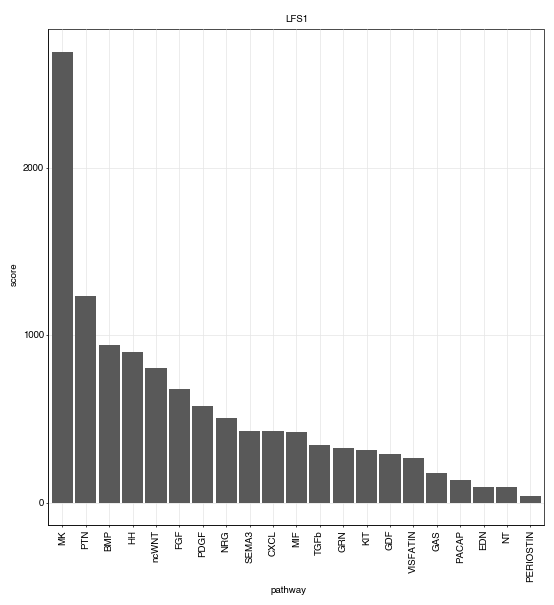

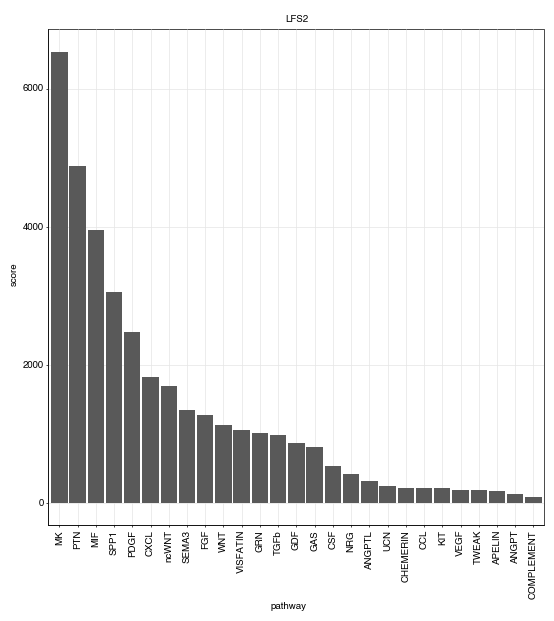

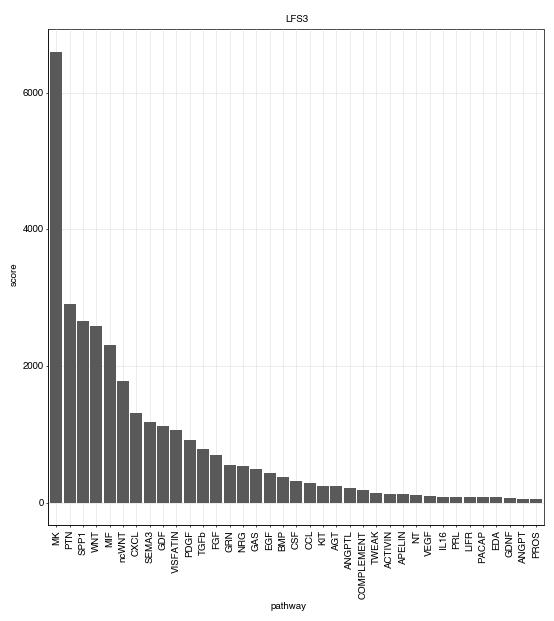

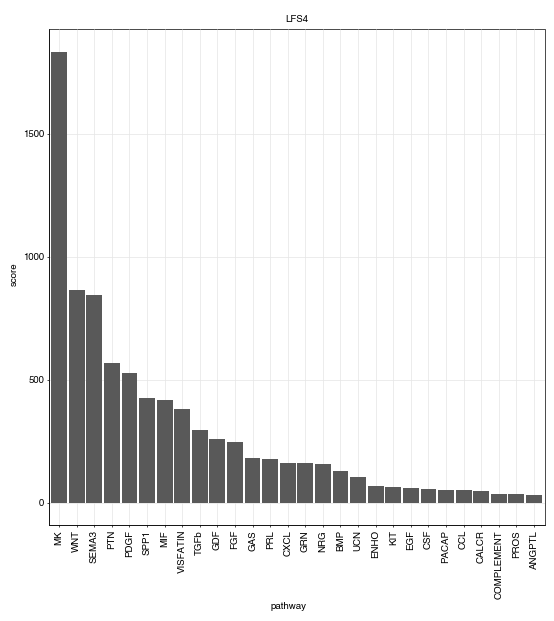

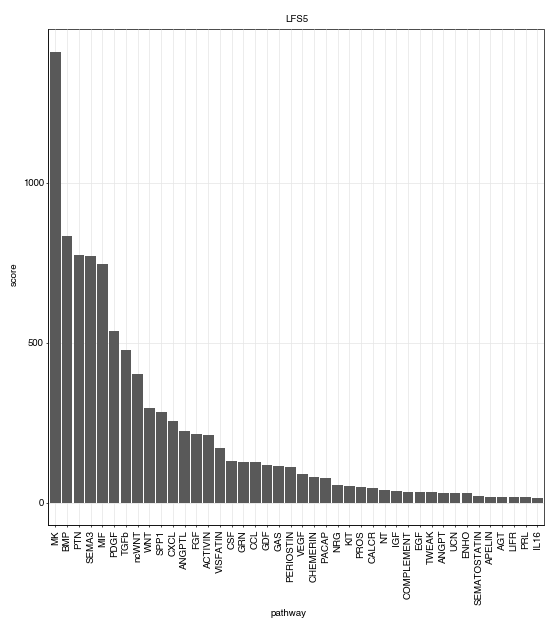

...

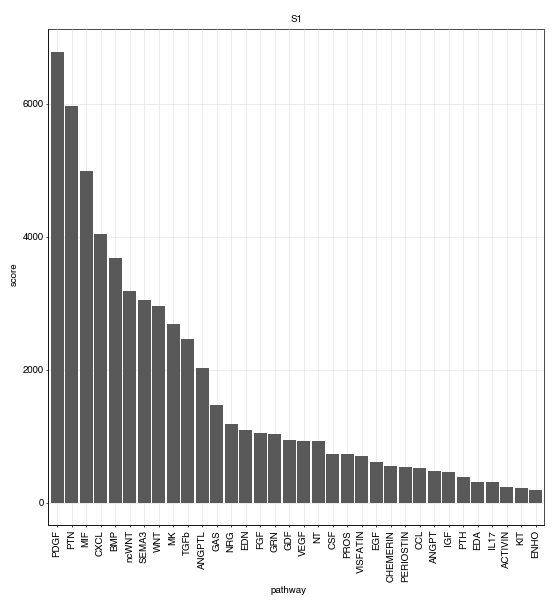

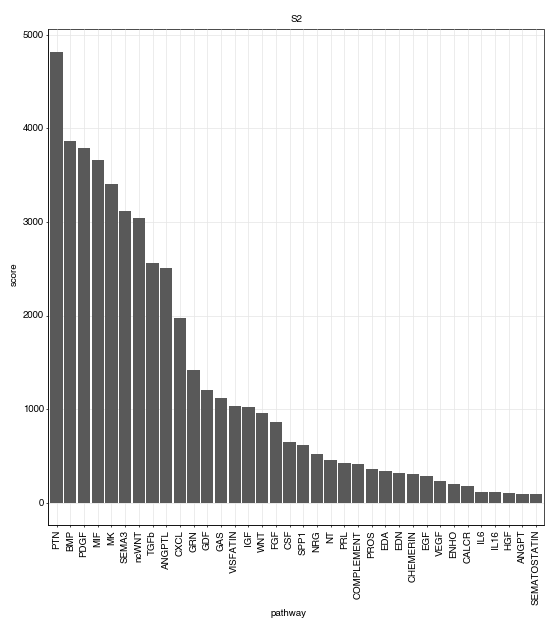

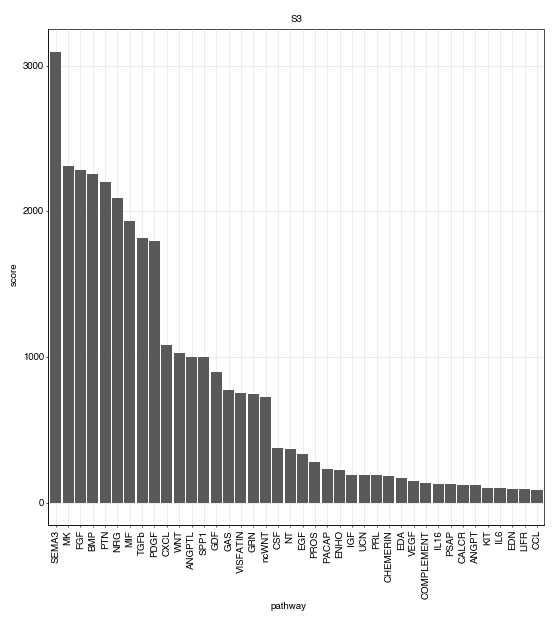

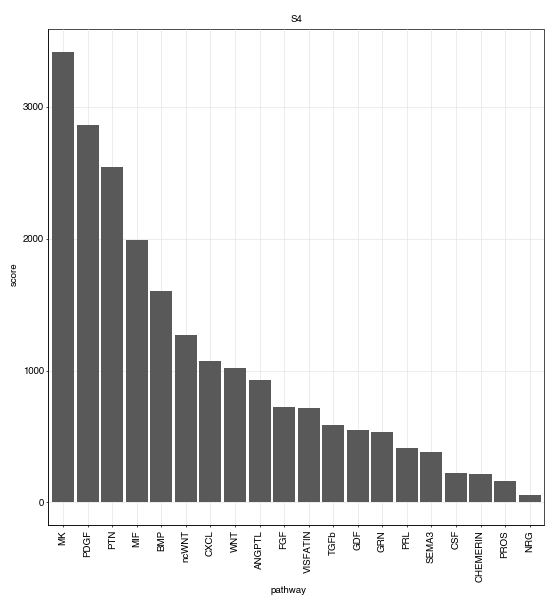

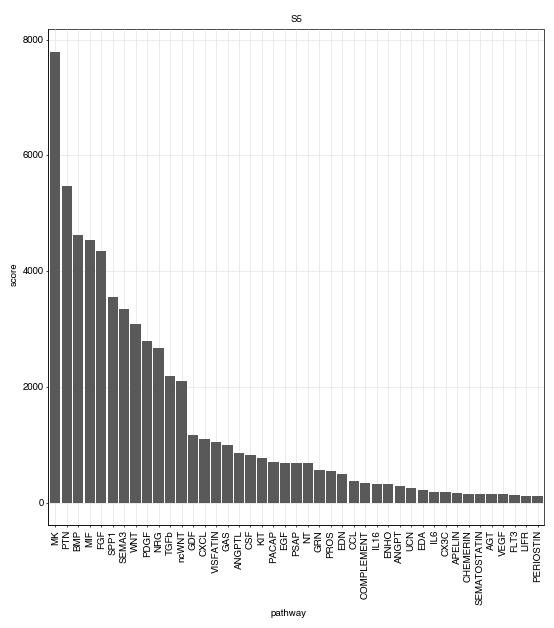

In [7]:
for sname, subdf in scores.groupby("sample"):
    subdf[
        "pathway"
    ] = subdf.pathway.cat.remove_unused_categories().cat.reorder_categories(
        new_categories=subdf.sort_values("score", ascending=False).pathway.to_list(),
        ordered=True,
    )
    print(
        ggplot(subdf, aes("pathway", "score"))
        + geom_bar(stat="identity")
        + facet_wrap("sample", ncol=4, scales="free", labeller=human_sample_map)
        + theme(
            axis_text_x=element_text(rotation=90),
            panel_spacing_x=0.5,
            panel_spacing_y=1,
        )
    )

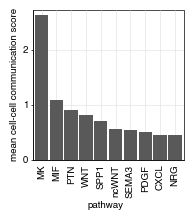

<ggplot: (8782216350937)>

In [8]:
p = (
    ggplot(
        scores[scores["sample"] == "3.4"]
        .sort_values("score", ascending=False)[:10]
        .assign(
            score=lambda x: x.score / x.nspots,
            pathway=lambda x: x.pathway.cat.remove_unused_categories().cat.reorder_categories(
                new_categories=x.pathway.to_list()
            ),
        )
        .reset_index(drop=True),
        aes("pathway", "score"),
    )
    + geom_bar(stat="identity")
    + scale_y_continuous(
        name="mean cell-cell communication score", expand=(0, 0, 0.04, 0)
    )
    + theme(
        axis_text_x=element_text(rotation=90),
        axis_ticks_major_x=element_blank(),
        aspect_ratio="auto",
        figure_size=(1.95, 1.95),
    )
)
p.save("figures/3D_barplot.svgz")
p

In [9]:
for sname, adata in adatas.items():
    for p in scores[scores["sample"] == sname].pathway.unique():
        ct.tl.communication_direction(adata, database_name="CellChat", pathway_name=p)

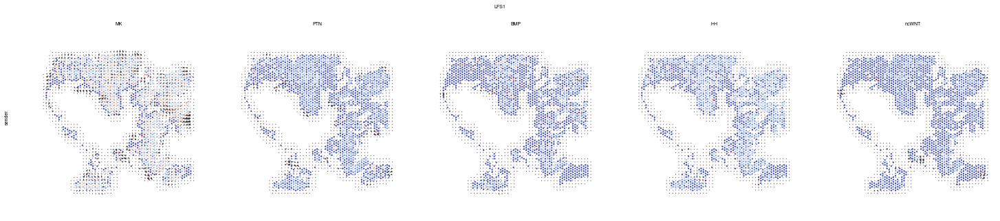

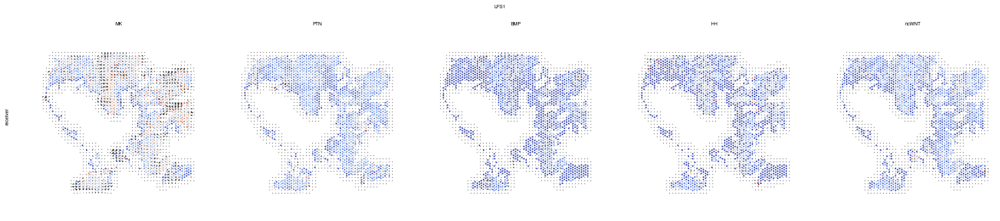

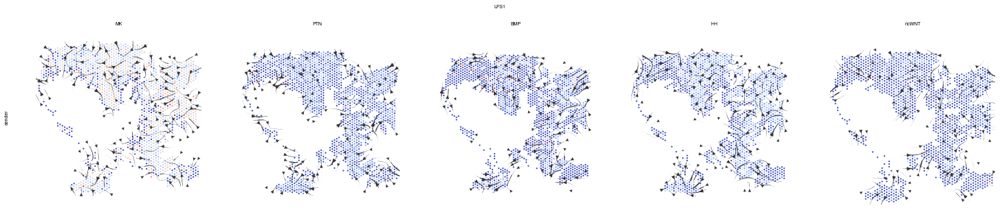

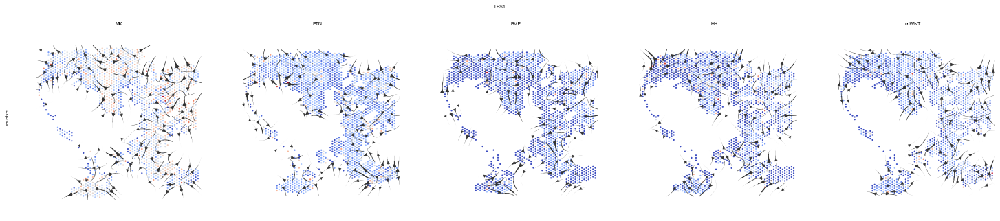

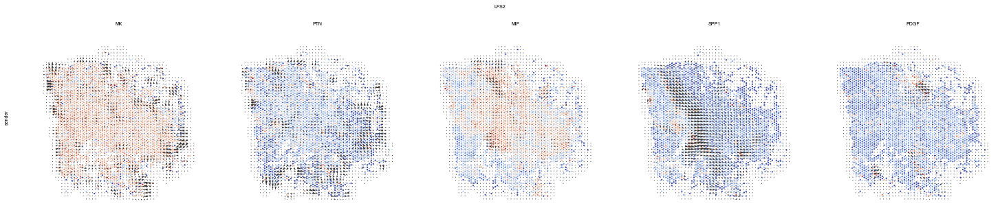

...

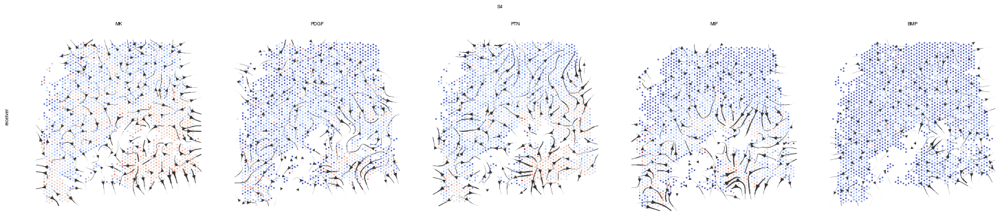

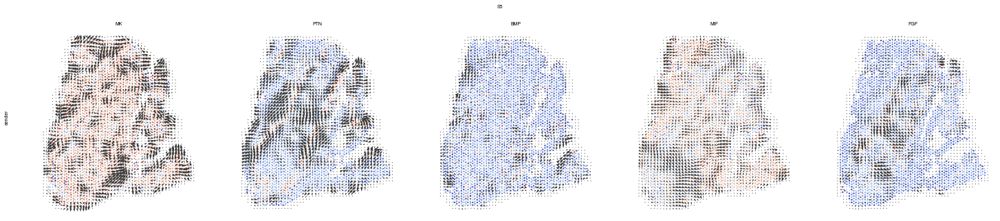

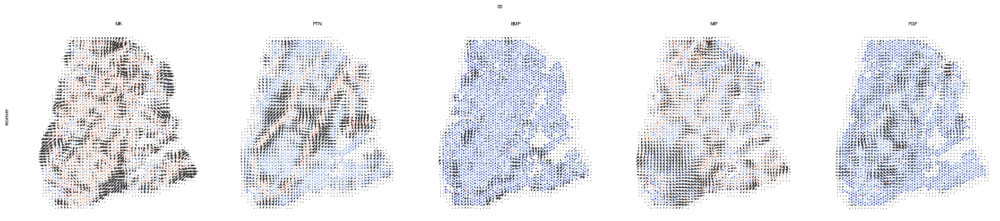

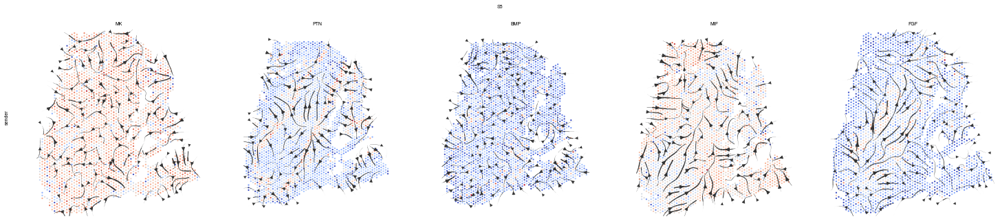

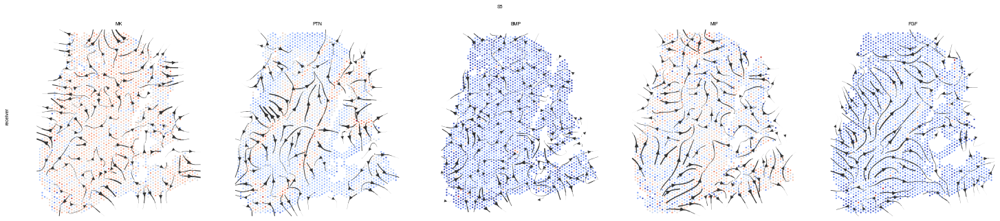

In [10]:
n_top_pathways = 5

for sname in sorted(adatas.keys()):
    adata = adatas[sname].copy()
    adata.obsm["spatial"] = (
        adata.obsm["spatial"] / 300
    )  # grid plotting is sensitive to coordinate scaling
    pathways = (
        scores[scores["sample"] == sname]
        .sort_values("score", ascending=False)
        .pathway[:n_top_pathways]
        .to_list()
    )
    for method in ("grid", "stream"):
        for summary in ("sender", "receiver"):
            fig = plt.figure(figsize=(25, 5))
            for i, p in enumerate(pathways):
                ax = fig.add_subplot(1, n_top_pathways, i + 1)
                ct.pl.plot_cell_communication(
                    adata,
                    database_name="CellChat",
                    pathway_name=p,
                    summary=summary,
                    ndsize=5,
                    plot_method=method,
                    ax=ax,
                )
                ax.set_title(p)
                ax.invert_yaxis()
            fig.suptitle(human_sample_map[sname])
            fig.text(0.1, 0.5, summary, rotation=90)

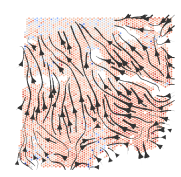

In [11]:
with mpl.rc_context({"figure.figsize": (3, 3)}):
    adata = adatas["3.4"].copy()
    adata.obsm["spatial"] = adata.obsm["spatial"] / 300
    ct.pl.plot_cell_communication(
                    adata,
                    database_name="CellChat",
                    pathway_name="MK",
                    summary="sender",
                    ndsize=3,
                    plot_method="stream"
                )
    plt.gca().invert_yaxis()
    plt.savefig("figures/3D_streamplot.svgz")

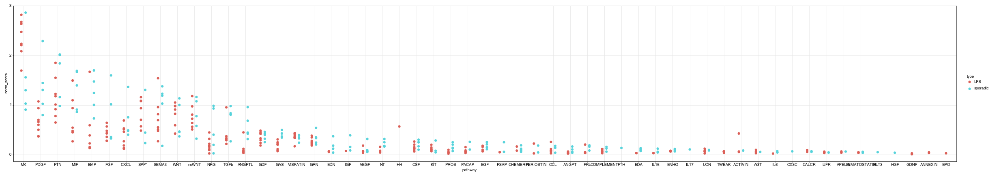

<ggplot: (8782213403769)>

In [12]:
scores = scores.assign(
    norm_score=scores.score / scores.nspots,
    type=lambda x: np.where(x["sample"].str[0].astype(int) <= 3, "LFS", "sporadic"),
)
(
    ggplot(scores, aes("pathway", "norm_score", color="type"))
    + geom_jitter(position=position_dodge(width=0.5))
    + theme(aspect_ratio="auto", figure_size=(30, 5))
)

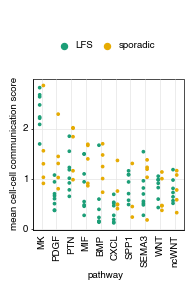

<ggplot: (8782158330001)>

In [13]:
p = (
    ggplot(
        scores[
            scores.pathway.isin(
                scores.groupby("pathway")["score"]
                .agg("sum")
                .sort_values(ascending=False)[:10]
                .index
            )
        ],
        aes("pathway", "norm_score", color="type"),
    )
    + geom_jitter(size=0.5, position=position_dodge(width=0.5))
    + guides(color=guide_legend(override_aes={"size": 2}))
    + lfs_sporadic_color_scale
    + labs(y="mean cell-cell communication score", color="")
    + theme(
        axis_text_x=element_text(rotation=90),
        axis_ticks_major_x=element_blank(),
        figure_size=(1.95, 1.95),
        legend_position="top"
    )
)
p.save("figures/3E_dotplot.svgz")
p